In [265]:
#pip install numpy

In [266]:
#pip install -U ydata-profiling

In [267]:
import pandas as pd
import json
import os
from collections import Counter
import numpy as np
from ydata_profiling import ProfileReport

In [268]:
pwd

'/Users/s2531396/Library/CloudStorage/OneDrive-UniversityofEdinburgh/PhD/Code/extracted'

In [269]:
data_dir = '/Users/s2531396/Library/CloudStorage/OneDrive-UniversityofEdinburgh/PhD/Code'

### Functions

In [270]:
cd extracted/

[Errno 2] No such file or directory: 'extracted/'
/Users/s2531396/Library/CloudStorage/OneDrive-UniversityofEdinburgh/PhD/Code/extracted


In [271]:
def json_files_to_df():
    json_files = [f for f in os.listdir() if f.endswith('.json')]
    
    for json_file in json_files:
        df = one_json_to_df(json_file)
        dfs.append(df)

In [272]:
def one_json_to_df (file):
    json_file = open(file)
    json_dicc = json.load(json_file)
    df_generalDesc = pd.json_normalize(json_dicc['generalDesc'])
    df_contributionDesc_authors = pd.json_normalize(json_dicc ['contributionDesc']['authors'])
    df_curators = pd.json_normalize(json_dicc ['contributionDesc']['curators'])
    df_institutions = pd.json_normalize(json_dicc ['contributionDesc']['institutions'])
    df_fundings = pd.json_normalize(json_dicc ['contributionDesc']['fundings'])
    df_experimentalDetails = pd.json_normalize(json_dicc ['experimentalDetails'])
    df_characteristics = pd.json_normalize(json_dicc ['characteristic'])
    df_bioDescrip = pd.json_normalize(json_dicc ['bioDescription'])
    df_summary = pd.json_normalize(json_dicc ['bioSummary'])
    df_provenance = pd.json_normalize(json_dicc ['provenance'])
            
    df_institutions = df_institutions.rename(columns={'name':'institution_name','longName':'logName'})
            
    working_df = pd.concat([df_generalDesc, df_contributionDesc_authors, df_curators,
                            df_institutions, df_fundings, df_experimentalDetails, df_characteristics,
                            df_bioDescrip, df_summary, df_provenance], axis=1)
            
    working_df['species'] = json_dicc ['species']
    working_df['dataCategory'] = json_dicc ['dataCategory']
    working_df['id_experiment'] = json_dicc ['id']

    return working_df

### Functions for one data frame

In [273]:
# For one data frame
def count_words(phrase):
    words = phrase.split()
    return len(words)

In [274]:
# For one data frame
def character_long (new_list, row_header, number_of_elements,df):
    for value in number_of_elements:
        valor = len(df[row_header][value])
        new_list.append(valor)
    return new_list

In [275]:
#For one data frame
def number_of_words (row_header, number_of_elements, df,lista):
    for value in number_of_elements:
        phrase = df[row_header][value]
        words_test = count_words(phrase)
        lista.append(words_test)
    return lista

In [276]:
#For one data frame
def missing_values_table(df): 
        mis_val = df.isnull().sum()
        mis_val_percent = 100 * df.isnull().sum()/len(df)
        mis_val_table = pd.concat([mis_val, mis_val_percent], axis=1)
        mis_val_table_ren_columns = mis_val_table.rename(
        columns = {0 : 'Missing Values', 1 : '% of Total Values'})
        return mis_val_table_ren_columns 

In [277]:
#For one data frame
def entities_recognition(feature,df):
    lista = []
    count = 0
    while count < len(df):
        phrase = df[feature][count]
        doc_phrase = nlp(phrase)
        value_to_list = list(doc_phrase.ents)
        lista.append(value_to_list)
        count += 1
        
    return lista

In [278]:
#For one data frame
def lista_entities_to_strings(lista):
    count = 0
    lista_all_strings = []
    while count < len(lista):
        list_of_string = [span.text for span in lista[count]]
        lista_all_strings.append(list_of_string)
        count +=1

    return lista_all_strings

In [279]:
#For one data frame
def count_entities (feature,df):
    count = 0
    lista_amount = []
    while count < len(df):
        value = len(df[feature][count])
        lista_amount.append(value)
        count += 1
        
    return lista_amount

## Analysing all json files

### Open all files

In [280]:
#cd extracted/

In [281]:
json_files = [f for f in os.listdir() if f.endswith('.json')]
json_files

['23684.json',
 '24141.json',
 '13232.json',
 '22996.json',
 '16030.json',
 '26486.json',
 '21343.json',
 '13662.json',
 '12970.json',
 '24511.json',
 '21713.json',
 '20801.json',
 '16460.json',
 '13398.json',
 '19795.json',
 '18887.json',
 '25750.json',
 '22095.json',
 '12423.json',
 '24842.json',
 '17621.json',
 '20552.json',
 '16933.json',
 '12073.json',
 '25300.json',
 '16899.json',
 '20102.json',
 '17271.json',
 '18184.json',
 '15759.json',
 '17764.json',
 '16876.json',
 '20417.json',
 '18491.json',
 '25615.json',
 '24907.json',
 '12566.json',
 '15309.json',
 '17334.json',
 '26890.json',
 '12136.json',
 '22580.json',
 '25245.json',
 '16175.json',
 '14148.json',
 '21206.json',
 '19280.json',
 '18868.json',
 '24004.json',
 '26039.json',
 '13377.json',
 '21656.json',
 '26193.json',
 '16525.json',
 '22979.json',
 '20944.json',
 '14518.json',
 '13727.json',
 '24454.json',
 '23391.json',
 '12835.json',
 '26469.json',
 '22353.json',
 '25496.json',
 '15020.json',
 '21986.json',
 '20694.js

In [282]:
dfs =[]

In [283]:
for json_file in json_files:
    df = one_json_to_df(json_file)
    dfs.append(df)

In [284]:
for i, df in enumerate(dfs):
    print(f"DataFrame {i+1}:")
    print(df)
    print('\n'+'-'*40 + '\n')

DataFrame 1:
                           name  \
0  Re-crop_FormalExp-1st_syst-1   

                                             purpose description comments  \
0  To analyze the motion of arabidopsis to check ...        None     None   

     id         login firstName lastName ORCID            institution_name  \
0  3009  sherrysclock   NiChiao     Tsai  None  National Taiwan University   

   ... materialTypes materialOrigins customTags externalIds  \
0  ...            []              []         []          []   

                                created     createdBy  \
0  [2022, 10, 13, 5, 57, 37, 651925979]  NiChiao Tsai   

                             modified    modifiedBy  dataCategory  \
0  [2023, 2, 8, 8, 15, 23, 807726379]  NiChiao Tsai   GEN_IMAGING   

   id_experiment  
0          23684  

[1 rows x 47 columns]

----------------------------------------

DataFrame 2:
                name                                            purpose  \
0  Patch 3 - Resumen  -value / 

                                         name  \
0  2021-11-8-drugscreen-wt-p03d1-d11-5percent   

                                             purpose description comments  \
0  2021 -11-8- drugscreen -wt- p03 d1-d11 -5perce...        None     None   

     id         login firstName lastName ORCID    institution_name  ...  \
0  2426  zhongzhaomin   Zhaomin    Zhong  None  Soochow University  ...   

  materialTypes materialOrigins customTags externalIds  \
0            []              []         []          []   

                              created      createdBy  \
0  [2022, 1, 12, 7, 58, 2, 300949909]  Zhaomin Zhong   

                            modified     modifiedBy  dataCategory  \
0  [2022, 1, 12, 8, 0, 1, 606696265]  Zhaomin Zhong     BEHAVIOUR   

   id_experiment  
0          21319  

[1 rows x 47 columns]

----------------------------------------

DataFrame 2628:
             name                                            purpose  \
0  4.10 level7 T   Life was like a

     name                                            purpose description  \
0  220926  measuring circadian period of tor mutants in c...        None   

  comments    id  login firstName lastName ORCID         institution_name  \
0     None  2442  bm559   Breagha   Magill  None  University of Cambridge   

   ... materialTypes materialOrigins customTags externalIds  \
0  ...            []              []         []          []   

                               created       createdBy  \
0  [2022, 10, 3, 18, 24, 8, 518988625]  Breagha Magill   

                               modified      modifiedBy   dataCategory  \
0  [2022, 10, 3, 21, 44, 33, 690289113]  Breagha Magill  EXPR_REPORTER   

   id_experiment  
0          23587  

[1 rows x 47 columns]

----------------------------------------

DataFrame 5607:
                                                name  \
0  RNA immunoprecipitation quantitative polymeras...   

                                             purpose  \
0  re anno

                                                name  \
0  F1-F2 LD. Testing the conservation of nocturna...   

                                             purpose  \
0  The objective is to test the activity of F1 wh...   

                                         description comments    id   login  \
0  using TriKinetics, fly aged 2-5 d old. around ...     None  1673  tauber   

  firstName lastName ORCID     institution_name  ... materialTypes  \
0      Eran   Tauber  None  University of Haifa  ...            []   

  materialOrigins customTags externalIds                             created  \
0              []         []          []  [2018, 6, 27, 8, 44, 2, 841000000]   

     createdBy                             modified   modifiedBy  \
0  Eran Tauber  [2018, 6, 27, 9, 59, 17, 713000000]  Eran Tauber   

   dataCategory  id_experiment  
0     BEHAVIOUR          12817  

[1 rows x 46 columns]

----------------------------------------

DataFrame 12692:
                       name

In [285]:
dfs[1]

,name,purpose,description,comments,id,login,firstName,lastName,ORCID,institution_name,...,materialTypes,materialOrigins,customTags,externalIds,created,createdBy,modified,modifiedBy,dataCategory,id_experiment
0,Patch 3 - Resumen,-value / parametric / Rhythm detection of the ...,None,None,3071,israxgal,Israeli,Galicia,None,UVG,...,[],[],[],[],"[2022, 12, 5, 15, 22, 52, 823508295]",Israeli Galicia,"[2022, 12, 5, 15, 24, 1, 116204114]",Israeli Galicia,OTHER,24141


### Editing Data Frame

###### Removing columns

In [286]:
def column_to_remove(list_of_df, column_to_remove):
    for i, df in enumerate(dfs):
        if column_to_remove in df.columns:
            dfs[i] = df.drop(columns = column_to_remove)
        else:
            print(f"Data frame {i+1} does not have the column:'{column_to_remove}'.")

In [287]:
list_columns_to_remove = ["ORCID", "growthEnvironments.environments", "experimentalEnvironments.environments",
                         "licence", "bios", "labels", "ecotypes", "genotypes", "markers", "lines", 
                          "growthStages", "tagTypes", "materialTypes", "materialOrigins", "customTags",
                         "externalIds", "createdBy"]

In [288]:
for title in list_columns_to_remove:
    column_to_remove(dfs,title)
    print(title)

ORCID
growthEnvironments.environments
experimentalEnvironments.environments
Data frame 74 does not have the column:'licence'.
Data frame 80 does not have the column:'licence'.
Data frame 84 does not have the column:'licence'.
Data frame 89 does not have the column:'licence'.
Data frame 101 does not have the column:'licence'.
Data frame 116 does not have the column:'licence'.
Data frame 151 does not have the column:'licence'.
Data frame 161 does not have the column:'licence'.
Data frame 193 does not have the column:'licence'.
Data frame 203 does not have the column:'licence'.
Data frame 212 does not have the column:'licence'.
Data frame 214 does not have the column:'licence'.
Data frame 231 does not have the column:'licence'.
Data frame 245 does not have the column:'licence'.
Data frame 315 does not have the column:'licence'.
Data frame 325 does not have the column:'licence'.
Data frame 328 does not have the column:'licence'.
Data frame 333 does not have the column:'licence'.
Data frame

ecotypes
genotypes
markers
lines
growthStages
tagTypes
materialTypes
materialOrigins
customTags
externalIds
createdBy


In [289]:
dfs[1]

,name,purpose,description,comments,id,login,firstName,lastName,institution_name,logName,...,biodare1Id,isOpenAccess,hasRhythmicityJobs,dataCategories,species,created,modified,modifiedBy,dataCategory,id_experiment
0,Patch 3 - Resumen,-value / parametric / Rhythm detection of the ...,None,None,3071,israxgal,Israeli,Galicia,UVG,UVG,...,0,False,True,[],Homo sapiens,"[2022, 12, 5, 15, 22, 52, 823508295]","[2022, 12, 5, 15, 24, 1, 116204114]",Israeli Galicia,OTHER,24141


###### Replacing None for nothing

In [290]:
for i, df in enumerate(dfs):
    df.replace(to_replace=[None], value="", inplace=True)

In [291]:
dfs[1]

,name,purpose,description,comments,id,login,firstName,lastName,institution_name,logName,...,biodare1Id,isOpenAccess,hasRhythmicityJobs,dataCategories,species,created,modified,modifiedBy,dataCategory,id_experiment
0,Patch 3 - Resumen,-value / parametric / Rhythm detection of the ...,,,3071,israxgal,Israeli,Galicia,UVG,UVG,...,0,False,True,[],Homo sapiens,"[2022, 12, 5, 15, 22, 52, 823508295]","[2022, 12, 5, 15, 24, 1, 116204114]",Israeli Galicia,OTHER,24141


### Number of words

In [292]:
def number_of_words (row_header, number_of_elements, df,lista):
    count = 0
    for value in number_of_elements:
        
        if count < len(df):
            objeto = df[value][row_header]
            complete_phrase = objeto.to_string()
            phrase = complete_phrase.split()
            phrase.pop(0)
            total_number = len(phrase)
            lista.append(total_number)
            count +=1
        else:
            break
    return lista

In [293]:
len(dfs)

15424

In [294]:
def createList(r1, r2):
    return list(range(r1, r2+1))

In [295]:
all_elements = createList(0,len(dfs))
type(all_elements)

list

#### Purpouse

In [296]:
new_list_4 = []
row_header = "purpose"
purpose_number_words = number_of_words(row_header,all_elements,dfs,new_list_4)
purpose_number_words

[9,
 9,
 10,
 8,
 6,
 9,
 8,
 9,
 9,
 8,
 9,
 7,
 9,
 8,
 5,
 9,
 9,
 8,
 7,
 8,
 6,
 8,
 6,
 9,
 7,
 7,
 9,
 9,
 8,
 11,
 10,
 8,
 10,
 7,
 8,
 7,
 8,
 8,
 8,
 7,
 7,
 8,
 9,
 6,
 11,
 5,
 9,
 9,
 9,
 8,
 6,
 8,
 6,
 9,
 7,
 10,
 8,
 7,
 7,
 12,
 8,
 8,
 11,
 9,
 7,
 7,
 7,
 7,
 6,
 7,
 9,
 9,
 7,
 11,
 9,
 8,
 6,
 10,
 10,
 11,
 10,
 9,
 10,
 6,
 9,
 7,
 7,
 8,
 10,
 10,
 9,
 6,
 7,
 7,
 8,
 8,
 9,
 7,
 7,
 6,
 9,
 7,
 7,
 7,
 9,
 7,
 8,
 9,
 9,
 10,
 6,
 7,
 6,
 5,
 8,
 8,
 6,
 9,
 6,
 7,
 7,
 8,
 8,
 7,
 7,
 4,
 9,
 10,
 7,
 8,
 7,
 7,
 8,
 6,
 8,
 7,
 9,
 8,
 9,
 9,
 11,
 10,
 9,
 6,
 7,
 10,
 8,
 9,
 5,
 8,
 6,
 9,
 10,
 8,
 7,
 7,
 9,
 8,
 9,
 5,
 8,
 8,
 7,
 8,
 7,
 7,
 6,
 8,
 9,
 10,
 6,
 9,
 5,
 9,
 7,
 4,
 7,
 8,
 7,
 6,
 7,
 8,
 8,
 6,
 9,
 10,
 7,
 9,
 9,
 7,
 7,
 8,
 8,
 10,
 9,
 10,
 7,
 3,
 6,
 9,
 9,
 10,
 6,
 8,
 9,
 8,
 7,
 7,
 9,
 7,
 9,
 8,
 10,
 7,
 9,
 8,
 9,
 9,
 10,
 8,
 7,
 8,
 9,
 7,
 7,
 9,
 8,
 8,
 10,
 9,
 9,
 9,
 7,
 7,
 6,
 6,
 10,
 7,
 7,
 5,
 6,
 10,


In [297]:
count = 0
while count < len(dfs):
    dfs[count]["number_of_words_purpose"] = purpose_number_words[count]
    count += 1

In [298]:
dfs[50]

,name,purpose,description,comments,id,login,firstName,lastName,institution_name,logName,...,biodare1Id,isOpenAccess,dataCategories,species,created,modified,modifiedBy,dataCategory,id_experiment,number_of_words_purpose
0,ll937 elf4luc(i+s),compare elf4luc rt lumi data(i+s)\nphase perio...,12 12grow up condition\nll measurement,,1835,weiweichen,weiwei,chen,crag,crag,...,0,False,[],Arabidopsis thaliana,"[2018, 10, 29, 19, 6, 37, 731000000]","[2018, 10, 29, 19, 7, 46, 205000000]",weiwei chen,EXPR_REPORTER,13377,6


#### Name

In [299]:
new_list_5 = []
row_header = "name"
name_number_words = number_of_words(row_header,all_elements,dfs,new_list_5)
name_number_words

[1,
 4,
 4,
 5,
 6,
 4,
 6,
 5,
 1,
 2,
 3,
 5,
 3,
 3,
 1,
 6,
 2,
 1,
 6,
 1,
 4,
 1,
 8,
 1,
 1,
 1,
 5,
 2,
 4,
 4,
 4,
 1,
 3,
 1,
 9,
 7,
 8,
 1,
 2,
 6,
 6,
 1,
 3,
 6,
 4,
 1,
 3,
 3,
 5,
 1,
 2,
 3,
 10,
 9,
 2,
 1,
 1,
 1,
 3,
 12,
 1,
 9,
 6,
 2,
 8,
 4,
 1,
 1,
 2,
 1,
 9,
 5,
 8,
 2,
 1,
 4,
 2,
 10,
 5,
 5,
 9,
 1,
 1,
 1,
 4,
 1,
 4,
 8,
 9,
 4,
 5,
 2,
 1,
 3,
 3,
 5,
 1,
 7,
 7,
 6,
 1,
 1,
 7,
 3,
 2,
 2,
 6,
 4,
 7,
 3,
 1,
 4,
 5,
 2,
 8,
 6,
 1,
 3,
 7,
 2,
 1,
 6,
 4,
 4,
 3,
 2,
 5,
 5,
 5,
 1,
 1,
 4,
 3,
 2,
 10,
 1,
 5,
 1,
 5,
 4,
 8,
 9,
 9,
 1,
 1,
 8,
 6,
 6,
 1,
 3,
 3,
 6,
 1,
 1,
 6,
 3,
 2,
 2,
 9,
 2,
 5,
 1,
 2,
 3,
 2,
 1,
 4,
 2,
 2,
 1,
 6,
 9,
 3,
 7,
 1,
 1,
 1,
 4,
 4,
 3,
 1,
 1,
 5,
 4,
 2,
 7,
 1,
 1,
 1,
 2,
 8,
 1,
 4,
 8,
 1,
 3,
 7,
 4,
 8,
 5,
 4,
 7,
 2,
 3,
 2,
 6,
 3,
 3,
 3,
 6,
 5,
 4,
 7,
 1,
 4,
 3,
 2,
 4,
 8,
 2,
 2,
 4,
 3,
 1,
 5,
 4,
 8,
 5,
 2,
 3,
 2,
 5,
 7,
 7,
 6,
 5,
 6,
 3,
 2,
 1,
 4,
 1,
 4,
 6,
 1,
 8,
 4,
 7,
 2,


In [300]:
count = 0
while count < len(dfs):
    dfs[count]["number_of_words_name"] = name_number_words[count]
    count += 1

In [301]:
dfs[50]

,name,purpose,description,comments,id,login,firstName,lastName,institution_name,logName,...,isOpenAccess,dataCategories,species,created,modified,modifiedBy,dataCategory,id_experiment,number_of_words_purpose,number_of_words_name
0,ll937 elf4luc(i+s),compare elf4luc rt lumi data(i+s)\nphase perio...,12 12grow up condition\nll measurement,,1835,weiweichen,weiwei,chen,crag,crag,...,False,[],Arabidopsis thaliana,"[2018, 10, 29, 19, 6, 37, 731000000]","[2018, 10, 29, 19, 7, 46, 205000000]",weiwei chen,EXPR_REPORTER,13377,6,2


#### Description

In [302]:
new_list_7 = []
row_header = "description"
description_number_words = number_of_words(row_header,all_elements,dfs,new_list_7)
description_number_words

[0,
 0,
 4,
 0,
 0,
 0,
 0,
 0,
 6,
 0,
 0,
 0,
 0,
 1,
 0,
 5,
 0,
 0,
 7,
 0,
 6,
 9,
 4,
 0,
 0,
 8,
 0,
 9,
 0,
 0,
 0,
 0,
 10,
 0,
 0,
 0,
 0,
 0,
 0,
 8,
 0,
 0,
 8,
 8,
 0,
 0,
 0,
 0,
 0,
 0,
 5,
 0,
 0,
 8,
 7,
 0,
 0,
 0,
 0,
 0,
 0,
 8,
 0,
 0,
 7,
 11,
 0,
 7,
 0,
 0,
 8,
 9,
 7,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 9,
 0,
 11,
 0,
 0,
 0,
 9,
 0,
 0,
 0,
 0,
 0,
 8,
 10,
 0,
 0,
 0,
 0,
 0,
 8,
 5,
 0,
 5,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 8,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 8,
 0,
 0,
 0,
 6,
 0,
 7,
 9,
 0,
 4,
 0,
 7,
 9,
 6,
 0,
 0,
 0,
 0,
 10,
 0,
 0,
 0,
 0,
 0,
 0,
 5,
 6,
 0,
 0,
 0,
 0,
 7,
 0,
 0,
 0,
 0,
 0,
 2,
 0,
 9,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 10,
 0,
 0,
 12,
 0,
 10,
 0,
 10,
 0,
 8,
 0,
 7,
 5,
 0,
 0,
 0,
 0,
 8,
 8,
 0,
 8,
 0,
 0,
 0,
 8,
 9,
 8,
 0,
 0,
 0,
 8,
 6,
 9,
 0,
 0,
 7,
 0,
 9,
 9,
 0,
 11,
 0,
 12,
 10,
 7,
 7,
 0,
 0,
 1,
 6,
 8,
 0,
 0,
 8,
 0,
 6,
 0,
 7,
 8,
 0,
 1,
 0,


In [303]:
count = 0
while count < len(dfs):
    dfs[count]["number_of_words_description"] = description_number_words[count]
    count += 1

In [304]:
dfs[2]

,name,purpose,description,comments,id,login,firstName,lastName,institution_name,logName,...,dataCategories,species,created,modified,modifiedBy,dataCategory,id_experiment,number_of_words_purpose,number_of_words_name,number_of_words_description
0,10012018 gst3-luc in ppp1,first time to run gst3-luc in wt and cross pro...,result is really weird...,,1324,dzhaolan,Zhaolan,Ding,TAMU,TAMU,...,[],Neurospora crassa,"[2018, 10, 2, 2, 57, 55, 178000000]","[2018, 10, 2, 3, 1, 9, 265000000]",Zhaolan Ding,EXPR_REPORTER,13232,10,4,4


#### Comments

In [305]:
new_list_9 = []
row_header = "comments"
comments_number_words = number_of_words(row_header,all_elements,dfs,new_list_9)
comments_number_words

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 7,
 0,
 0,
 0,
 0,
 0,
 0,
 8,
 0,
 0,
 0,
 0,
 0,
 7,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 6,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 8,
 0,
 0,
 0,
 6,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 5,
 0,
 0,
 0,
 0,
 0,
 5,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 10,
 0,
 0,
 0,
 0,
 7,
 0,
 0,
 0,
 8,
 0,
 7,
 6,
 0,
 0,
 0,
 0,
 2,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 8,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 10,
 0,
 0,
 0,
 0,
 1,
 6,
 0,
 0,
 0,
 0,
 0,
 6,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0

In [306]:
count = 0
while count < len(dfs):
    dfs[count]["number_of_words_comments"] = comments_number_words[count]
    count += 1

In [307]:
dfs[1]

,name,purpose,description,comments,id,login,firstName,lastName,institution_name,logName,...,species,created,modified,modifiedBy,dataCategory,id_experiment,number_of_words_purpose,number_of_words_name,number_of_words_description,number_of_words_comments
0,Patch 3 - Resumen,-value / parametric / Rhythm detection of the ...,,,3071,israxgal,Israeli,Galicia,UVG,UVG,...,Homo sapiens,"[2022, 12, 5, 15, 22, 52, 823508295]","[2022, 12, 5, 15, 24, 1, 116204114]",Israeli Galicia,OTHER,24141,9,4,0,0


### Number of characters

In [308]:
def character_long (row_header, number_of_elements, df, new_list):
    count = 0
    for value in number_of_elements:
        if count < len(df):
            valor = len(df[value][row_header][0])
            new_list.append(valor)
            count +=1
        else:
            break
    return new_list

In [309]:
len(dfs[0]["purpose"][0])

91

#### Name

In [310]:
new_list_12 = []
row_header = "name"
name_number_characters = character_long(row_header,all_elements,dfs,new_list_12)
name_number_characters

[28,
 17,
 25,
 32,
 59,
 33,
 31,
 34,
 7,
 19,
 12,
 34,
 17,
 19,
 69,
 35,
 15,
 37,
 45,
 15,
 20,
 12,
 58,
 20,
 10,
 10,
 27,
 20,
 23,
 27,
 22,
 19,
 15,
 25,
 58,
 59,
 51,
 7,
 15,
 49,
 61,
 6,
 22,
 91,
 29,
 42,
 14,
 18,
 35,
 14,
 18,
 20,
 51,
 50,
 6,
 7,
 28,
 8,
 21,
 75,
 30,
 45,
 36,
 10,
 65,
 24,
 67,
 17,
 21,
 10,
 51,
 36,
 67,
 8,
 22,
 29,
 44,
 83,
 23,
 26,
 33,
 9,
 16,
 16,
 29,
 24,
 23,
 57,
 50,
 29,
 42,
 17,
 36,
 18,
 16,
 34,
 11,
 37,
 64,
 90,
 10,
 16,
 49,
 12,
 10,
 8,
 40,
 20,
 61,
 13,
 16,
 20,
 39,
 9,
 53,
 27,
 28,
 17,
 71,
 27,
 9,
 31,
 34,
 28,
 19,
 40,
 35,
 35,
 55,
 12,
 20,
 23,
 16,
 15,
 55,
 6,
 27,
 31,
 30,
 32,
 99,
 86,
 52,
 9,
 33,
 40,
 40,
 29,
 24,
 13,
 31,
 42,
 27,
 8,
 46,
 22,
 10,
 8,
 46,
 15,
 31,
 24,
 17,
 27,
 10,
 41,
 23,
 8,
 23,
 31,
 62,
 60,
 39,
 47,
 19,
 15,
 35,
 19,
 32,
 9,
 13,
 8,
 35,
 18,
 8,
 35,
 10,
 22,
 21,
 16,
 67,
 36,
 19,
 58,
 12,
 14,
 100,
 30,
 43,
 33,
 26,
 47,
 6,
 21,

In [311]:
count = 0
while count < len(dfs):
    dfs[count]["number_of_characters_names"] = name_number_characters[count]
    count += 1

#### Purpose

In [312]:
new_list_13 = []
row_header = "purpose"
purpose_number_characters = character_long(row_header,all_elements,dfs,new_list_13)
purpose_number_characters

[91,
 64,
 75,
 91,
 62,
 67,
 90,
 63,
 94,
 73,
 56,
 61,
 87,
 65,
 73,
 60,
 74,
 63,
 103,
 66,
 63,
 74,
 76,
 79,
 93,
 75,
 55,
 62,
 68,
 88,
 76,
 68,
 69,
 56,
 105,
 75,
 69,
 89,
 69,
 65,
 55,
 94,
 56,
 114,
 61,
 65,
 86,
 85,
 71,
 69,
 56,
 93,
 138,
 83,
 66,
 81,
 84,
 58,
 78,
 75,
 97,
 144,
 55,
 55,
 166,
 62,
 133,
 66,
 60,
 78,
 75,
 129,
 125,
 72,
 68,
 71,
 81,
 83,
 67,
 57,
 65,
 95,
 66,
 64,
 94,
 80,
 87,
 57,
 95,
 81,
 70,
 62,
 61,
 55,
 129,
 127,
 120,
 58,
 64,
 95,
 70,
 72,
 96,
 63,
 63,
 127,
 86,
 85,
 70,
 58,
 59,
 80,
 99,
 110,
 69,
 69,
 92,
 103,
 76,
 82,
 65,
 70,
 78,
 58,
 60,
 78,
 127,
 70,
 70,
 678,
 78,
 65,
 63,
 65,
 75,
 172,
 59,
 69,
 74,
 59,
 185,
 202,
 84,
 115,
 102,
 66,
 69,
 78,
 61,
 65,
 83,
 62,
 69,
 60,
 74,
 73,
 56,
 76,
 59,
 107,
 72,
 61,
 89,
 101,
 306,
 57,
 55,
 64,
 76,
 63,
 63,
 60,
 72,
 91,
 71,
 102,
 60,
 81,
 76,
 66,
 69,
 68,
 89,
 395,
 69,
 73,
 92,
 61,
 87,
 59,
 71,
 76,
 64,
 145,
 4

In [313]:
count = 0
while count < len(dfs):
    dfs[count]["number_of_characters_purpose"] = purpose_number_characters[count]
    count += 1

#### Description

In [314]:
new_list_14 = []
row_header = "description"
description_number_characters = character_long(row_header,all_elements,dfs,new_list_14)
description_number_characters

[0,
 0,
 25,
 0,
 0,
 0,
 0,
 0,
 31,
 0,
 0,
 0,
 0,
 2,
 0,
 31,
 0,
 0,
 47,
 0,
 40,
 36,
 23,
 0,
 0,
 41,
 0,
 63,
 0,
 0,
 0,
 0,
 54,
 0,
 0,
 0,
 0,
 0,
 0,
 68,
 0,
 0,
 80,
 496,
 0,
 0,
 0,
 0,
 0,
 0,
 37,
 0,
 0,
 125,
 66,
 0,
 0,
 0,
 0,
 0,
 0,
 144,
 0,
 0,
 224,
 57,
 0,
 66,
 0,
 0,
 123,
 124,
 306,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 52,
 0,
 208,
 0,
 0,
 0,
 157,
 0,
 0,
 0,
 0,
 0,
 42,
 140,
 0,
 0,
 0,
 0,
 0,
 50,
 114,
 0,
 32,
 0,
 0,
 0,
 0,
 4,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 169,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 678,
 0,
 0,
 0,
 53,
 0,
 172,
 98,
 0,
 27,
 0,
 432,
 467,
 47,
 0,
 0,
 0,
 0,
 80,
 0,
 0,
 0,
 0,
 0,
 0,
 37,
 143,
 0,
 0,
 0,
 0,
 73,
 0,
 0,
 0,
 0,
 0,
 20,
 0,
 61,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 73,
 0,
 0,
 182,
 0,
 51,
 0,
 58,
 0,
 116,
 0,
 217,
 19,
 0,
 0,
 0,
 0,
 141,
 50,
 0,
 64,
 0,
 0,
 0,
 161,
 176,
 57,
 0,
 0,
 0,
 156,
 27,
 127,
 0,
 0,
 250,
 0,
 77,
 147,
 0,
 128,
 0

In [315]:
count = 0
while count < len(dfs):
    dfs[count]["number_of_characters_description"] = description_number_characters[count]
    count += 1

In [316]:
dfs[2]

,name,purpose,description,comments,id,login,firstName,lastName,institution_name,logName,...,modifiedBy,dataCategory,id_experiment,number_of_words_purpose,number_of_words_name,number_of_words_description,number_of_words_comments,number_of_characters_names,number_of_characters_purpose,number_of_characters_description
0,10012018 gst3-luc in ppp1,first time to run gst3-luc in wt and cross pro...,result is really weird...,,1324,dzhaolan,Zhaolan,Ding,TAMU,TAMU,...,Zhaolan Ding,EXPR_REPORTER,13232,10,4,4,0,25,75,25


#### Comments

In [317]:
new_list_15 = []
row_header = "comments"
comments_number_characters = character_long(row_header,all_elements,dfs,new_list_15)
comments_number_characters

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 66,
 0,
 0,
 0,
 0,
 0,
 0,
 144,
 0,
 0,
 0,
 0,
 0,
 66,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 68,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 678,
 0,
 0,
 0,
 53,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 36,
 0,
 0,
 0,
 0,
 0,
 42,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 73,
 0,
 0,
 0,
 0,
 55,
 0,
 0,
 0,
 116,
 0,
 217,
 114,
 0,
 0,
 0,
 0,
 9,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 156,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 60,
 0,
 0,
 0,
 0,
 0,
 1239,
 0,
 0,
 0,
 0,
 0,
 60,
 0,
 0,
 0,

In [318]:
count = 0
while count < len(dfs):
    dfs[count]["number_of_characters_comments"] = comments_number_characters[count]
    count += 1

## Editing data frame - part 2

### Removing stop words

In [319]:
import spacy
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
 
nltk.download('stopwords')
print(stopwords.words('english'))

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/s2531396/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [320]:
stop_words = set(stopwords.words('english'))

In [321]:
example = dfs[3]["name"]

In [322]:
example[0]

'Cry1Luc WT, PER2(TAG), 10mM AlkK'

In [323]:
word_tokens = word_tokenize(example[0])
word_tokens

['Cry1Luc', 'WT', ',', 'PER2', '(', 'TAG', ')', ',', '10mM', 'AlkK']

In [324]:
filtered_sentence = [w for w in word_tokens if not w.lower() in stop_words]
filtered_sentence

['Cry1Luc', 'WT', ',', 'PER2', '(', 'TAG', ')', ',', '10mM', 'AlkK']

In [325]:
def removing_stop_words (df, feature, number_of_elements):
    count = 0
    filtered_sentence_list = []
    for value in number_of_elements:
        if count < len(df):
            example = df[count][feature][0]
            word_tokens = word_tokenize(example)
            filtered_sentence = [w for w in word_tokens if not w.lower() in stop_words]
            filtered_sentence_list.append(filtered_sentence)
            count+=1
        else:
            break
    return filtered_sentence_list

In [326]:
#filtered_sentence_list = []
name_wo_stop_words = removing_stop_words(dfs,"name", all_elements)
name_wo_stop_words

[['Re-crop_FormalExp-1st_syst-1'],
 ['Patch', '3', '-', 'Resumen'],
 ['10012018', 'gst3-luc', 'ppp1'],
 ['Cry1Luc', 'WT', ',', 'PER2', '(', 'TAG', ')', ',', '10mM', 'AlkK'],
 ['CCD2',
  '2020Ene31',
  'xc2307',
  'LNNccd',
  ':',
  'Entrenamiento',
  '22:28',
  'en',
  'LNNccd'],
 ['per2-4', 'circadian', 'rhythm', 'amplitude'],
 ['NIH-3T3', 'WT', 'lenti/E4', 'lenti', 'SET'],
 ['MINT-Fly', 'data', 'day-by-day', 'Weeks', '1-2'],
 ['gsn-luc'],
 ['re-2022-10-10', 'Col-0'],
 ['stage', 'one', 'os'],
 ['CL3.22', 'circadian', 'blood', 'samples'],
 ['Exp12', '9x9px', 'ROI'],
 ['ll931', 'prr9luc', 'sh+rt'],
 ['2021-6-20-DRUGSCREEN-RORA',
  '(',
  'A+B',
  ')',
  'PER2',
  '(',
  'C+D',
  ')',
  'WT',
  '(',
  'E+F',
  ')',
  '-A4',
  '(',
  '123',
  ')',
  'A7',
  '(',
  '456',
  ')',
  'DMSO',
  '(',
  '78',
  ')'],
 ['Clock', 'Reporters', '-', 'ACC', 'Gradient', '0-45'],
 ['Detrending', 'test'],
 ['2022-3-14-zzm-drugscreen-cp09h2+a2-11'],
 ['Exp2497', 'Accessions', 'High', 'ncRNA', 'expression

In [327]:
test = dfs

In [328]:
type(test)

list

In [329]:
dfs[3]

,name,purpose,description,comments,id,login,firstName,lastName,institution_name,logName,...,dataCategory,id_experiment,number_of_words_purpose,number_of_words_name,number_of_words_description,number_of_words_comments,number_of_characters_names,number_of_characters_purpose,number_of_characters_description,number_of_characters_comments
0,"Cry1Luc WT, PER2(TAG), 10mM AlkK",To see the effect on Cry1Luc transcriptional r...,,,2197,dwmac,David,McManus,MRC LMB,MRC LMB,...,EXPR_REPORTER,22996,8,5,0,0,32,91,0,0


In [330]:
string_with_newline = name_wo_stop_words[4]

In [331]:
string_with_newline

['CCD2',
 '2020Ene31',
 'xc2307',
 'LNNccd',
 ':',
 'Entrenamiento',
 '22:28',
 'en',
 'LNNccd']

In [332]:
dfs[4]['name_wo_stop_words'][0] = ['CCD2','2020Ene31','xc2307','LNNccd',':','Entrenamiento','22:28','en','LNNccd']
#dfs[4]['name_wo_stop_words'] = name_wo_stop_words[4]

KeyError: 'name_wo_stop_words'

In [ ]:
dfs[4]['name_wo_stop_words'][0] = name_wo_stop_words[4]

In [ ]:
dfs[4]['name_wo_stop_words'] = ''
dfs[4]['name_wo_stop_words'][0] = ['CCD2','2020Ene31','xc2307','LNNccd',':','Entrenamiento','22:28','en','LNNccd']

In [333]:
def add_column_wo_stop_words (dfs, title_wo_stop_words, feature_wo_stop_words):
    #count = 0
    for i in range(len(dfs)):
        working_df = dfs[i]
        working_df[title_wo_stop_words] = ''
        working_df[title_wo_stop_words][0] = feature_wo_stop_words[i]
        list(working_df[title_wo_stop_words][0])
        #working_df[title_wo_stop_words] = ''
        #working_df.loc[i,title_wo_stop_words] = feature_wo_stop_words[i]
        #working_df.at[0, title_wo_stop_words] = feature_wo_stop_words[i] 
        #count += 1

In [334]:
add_column_wo_stop_words(dfs, "name_wo_stop_words", name_wo_stop_words)

/var/folders/36/lqqg__8x3b1g2_q0m9s8gn_00000gq/T/ipykernel_45876/4261839205.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  working_df[title_wo_stop_words][0] = feature_wo_stop_words[i]
/var/folders/36/lqqg__8x3b1g2_q0m9s8gn_00000gq/T/ipykernel_45876/4261839205.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  working_df[title_wo_stop_words][0] = feature_wo_stop_words[i]
/var/folders/36/lqqg__8x3b1g2_q0m9s8gn_00000gq/T/ipykernel_45876/4261839205.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-d

/var/folders/36/lqqg__8x3b1g2_q0m9s8gn_00000gq/T/ipykernel_45876/4261839205.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  working_df[title_wo_stop_words][0] = feature_wo_stop_words[i]
/var/folders/36/lqqg__8x3b1g2_q0m9s8gn_00000gq/T/ipykernel_45876/4261839205.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  working_df[title_wo_stop_words][0] = feature_wo_stop_words[i]
/var/folders/36/lqqg__8x3b1g2_q0m9s8gn_00000gq/T/ipykernel_45876/4261839205.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-d

/var/folders/36/lqqg__8x3b1g2_q0m9s8gn_00000gq/T/ipykernel_45876/4261839205.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  working_df[title_wo_stop_words][0] = feature_wo_stop_words[i]
/var/folders/36/lqqg__8x3b1g2_q0m9s8gn_00000gq/T/ipykernel_45876/4261839205.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  working_df[title_wo_stop_words][0] = feature_wo_stop_words[i]
/var/folders/36/lqqg__8x3b1g2_q0m9s8gn_00000gq/T/ipykernel_45876/4261839205.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-d

In [335]:
example = dfs[50]['name_wo_stop_words'][0]

In [336]:
example

['ll937', 'elf4luc', '(', 'i+s', ')']

In [337]:
update_list = [item for item in example if '(' not in item]

In [338]:
update_list

['ll937', 'elf4luc', 'i+s', ')']

### Identifying entities

In [339]:
import scispacy
import spacy

nlp = spacy.load("../en_core_sci_sm-0.5.3")

In [340]:
def entities_recognition(dfs, feature):
    #count = 0
    lista = []
    for i in range(len(dfs)):
        phrase =  dfs[i][feature][0]
        doc_phrase = nlp(phrase)
        value_to_list = list(doc_phrase.ents)
        lista.append(value_to_list)
    return lista

In [341]:
phrase = dfs[1]["name"][0]

In [342]:
doc_phrase = nlp (phrase)

In [343]:
value_to_list = list(doc_phrase.ents)

In [344]:
value_to_list

[Patch 3, Resumen]

In [345]:
test = entities_recognition(dfs, "name")

In [346]:
test

[[Re-crop_FormalExp-1st_syst-1],
 [Patch 3, Resumen],
 [],
 [Cry1Luc WT, PER2(TAG, AlkK],
 [CCD2, xc2307 LNNccd, LNNccd],
 [per2, circadian rhythm amplitude],
 [NIH-3T3 WT lenti/E4 lenti SET],
 [MINT-Fly, Weeks],
 [gsn-luc],
 [Col-0],
 [stage],
 [CL3.22, circadian, blood samples],
 [Exp12, ROI],
 [ll931, prr9luc sh+rt],
 [],
 [Clock Reporters, ACC, Gradient],
 [Detrending test],
 [],
 [Exp2497, ncRNA, expression],
 [],
 [m82 LD],
 [VW041_LUM#1],
 [CCD2, Entrenamiento 22:28 16:8 3d, medio LNNccd],
 [kymographs_06Feb18_c],
 [],
 [],
 [WTDD, LncRNAs],
 [human's, temperature],
 [Slice, RCaMP, Baseline],
 [dclr1, ddCSP-1BS ADV-1LUC],
 [rna-seq wheat],
 [],
 [Control],
 [per1bdrugscreen-p10g1-g11],
 [3T3, PMTs, Cry1-Fluc],
 [Test, circadian rhythm, changes, substances, brain],
 [Per2:luc mice, Tissue Shift],
 [LUMO004],
 [Phase resetting],
 [BMDM, oscillation, seeding, densities],
 [circadian test, Arabidopsis lines, CAT3, variants],
 [化妆品6],
 [nanoglo test],
 [Bioluminescence, traces, XVE::

In [347]:
def add_column_entities (dfs, title_wo_stop_words, feature_entities):
    #count = 0
    for i in range(len(dfs)):
        working_df = dfs[i]
        working_df[title_wo_stop_words] = ''
        working_df[title_wo_stop_words][0] = feature_entities[i]
        list(working_df[title_wo_stop_words][0])

In [348]:
add_column_entities(dfs, "name_entities", test)

/var/folders/36/lqqg__8x3b1g2_q0m9s8gn_00000gq/T/ipykernel_45876/24717575.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  working_df[title_wo_stop_words][0] = feature_entities[i]
/var/folders/36/lqqg__8x3b1g2_q0m9s8gn_00000gq/T/ipykernel_45876/24717575.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  working_df[title_wo_stop_words][0] = feature_entities[i]
/var/folders/36/lqqg__8x3b1g2_q0m9s8gn_00000gq/T/ipykernel_45876/24717575.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_

/var/folders/36/lqqg__8x3b1g2_q0m9s8gn_00000gq/T/ipykernel_45876/24717575.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  working_df[title_wo_stop_words][0] = feature_entities[i]
/var/folders/36/lqqg__8x3b1g2_q0m9s8gn_00000gq/T/ipykernel_45876/24717575.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  working_df[title_wo_stop_words][0] = feature_entities[i]
/var/folders/36/lqqg__8x3b1g2_q0m9s8gn_00000gq/T/ipykernel_45876/24717575.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_

/var/folders/36/lqqg__8x3b1g2_q0m9s8gn_00000gq/T/ipykernel_45876/24717575.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  working_df[title_wo_stop_words][0] = feature_entities[i]
/var/folders/36/lqqg__8x3b1g2_q0m9s8gn_00000gq/T/ipykernel_45876/24717575.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  working_df[title_wo_stop_words][0] = feature_entities[i]
/var/folders/36/lqqg__8x3b1g2_q0m9s8gn_00000gq/T/ipykernel_45876/24717575.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_

In [349]:
dfs[10]["name_entities"][0]

[stage]

In [354]:
string_test = str(dfs[10]["name_entities"][0])

In [355]:
string_test

'[stage]'

In [359]:
lista_all = []
def list_of_list_entities (dfs, feature, empty_list):
    count = 0
    while count < len(dfs):
        lista_feature = dfs[count][feature][0]
        lista_all.extend(lista_feature)
        count += 1
            
    return lista_all

In [360]:
lista_entidades = list_of_list_entities(dfs, "name_entities", lista_all)

In [365]:
type(lista_entidades[50].text)

str

In [375]:
type(lista_entidades[50])

spacy.tokens.span.Span

In [376]:
lista_entidades_string =[]
for element in lista_entidades:
    string = element.text
    lista_entidades_string.append(string)

In [378]:
type(lista_entidades_string)

list

In [379]:
lista_entidades_string

['Re-crop_FormalExp-1st_syst-1',
 'Patch 3',
 'Resumen',
 'Cry1Luc WT',
 'PER2(TAG',
 'AlkK',
 'CCD2',
 'xc2307 LNNccd',
 'LNNccd',
 'per2',
 'circadian rhythm amplitude',
 'NIH-3T3 WT lenti/E4 lenti SET',
 'MINT-Fly',
 'Weeks',
 'gsn-luc',
 'Col-0',
 'stage',
 'CL3.22',
 'circadian',
 'blood samples',
 'Exp12',
 'ROI',
 'll931',
 'prr9luc sh+rt',
 'Clock Reporters',
 'ACC',
 'Gradient',
 'Detrending test',
 'Exp2497',
 'ncRNA',
 'expression',
 'm82 LD',
 'VW041_LUM#1',
 'CCD2',
 'Entrenamiento 22:28 16:8 3d',
 'medio LNNccd',
 'kymographs_06Feb18_c',
 'WTDD',
 'LncRNAs',
 "human's",
 'temperature',
 'Slice',
 'RCaMP',
 'Baseline',
 'dclr1',
 'ddCSP-1BS ADV-1LUC',
 'rna-seq wheat',
 'Control',
 'per1bdrugscreen-p10g1-g11',
 '3T3',
 'PMTs',
 'Cry1-Fluc',
 'Test',
 'circadian rhythm',
 'changes',
 'substances',
 'brain',
 'Per2:luc mice',
 'Tissue Shift',
 'LUMO004',
 'Phase resetting',
 'BMDM',
 'oscillation',
 'seeding',
 'densities',
 'circadian test',
 'Arabidopsis lines',
 'CAT3',
 

In [380]:
if 'CCD2' in lista_entidades_string:
    print('Found: CCD2 is in the list')
else:
    print('Not Found: CCD2 is not in the list')

Found: CCD2 is in the list


In [381]:
string_counts = Counter(lista_entidades_string)

for string, count in string_counts.items():
    print(f"{string}: {count} times")

Re-crop_FormalExp-1st_syst-1: 1 times
Patch 3: 3 times
Resumen: 3 times
Cry1Luc WT: 1 times
PER2(TAG: 1 times
AlkK: 107 times
CCD2: 74 times
xc2307 LNNccd: 1 times
LNNccd: 41 times
per2: 17 times
circadian rhythm amplitude: 14 times
NIH-3T3 WT lenti/E4 lenti SET: 1 times
MINT-Fly: 3 times
Weeks: 2 times
gsn-luc: 1 times
Col-0: 67 times
stage: 3 times
CL3.22: 1 times
circadian: 171 times
blood samples: 48 times
Exp12: 3 times
ROI: 50 times
ll931: 1 times
prr9luc sh+rt: 1 times
Clock Reporters: 2 times
ACC: 4 times
Gradient: 2 times
Detrending test: 4 times
Exp2497: 1 times
ncRNA: 2 times
expression: 83 times
m82 LD: 1 times
VW041_LUM#1: 1 times
Entrenamiento 22:28 16:8 3d: 2 times
medio LNNccd: 29 times
kymographs_06Feb18_c: 1 times
WTDD: 13 times
LncRNAs: 12 times
human's: 1 times
temperature: 22 times
Slice: 55 times
RCaMP: 29 times
Baseline: 36 times
dclr1: 6 times
ddCSP-1BS ADV-1LUC: 1 times
rna-seq wheat: 1 times
Control: 11 times
per1bdrugscreen-p10g1-g11: 1 times
3T3: 1 times
PMT

In [384]:
number_counts_per_feature = []
name_of_entity = []
for element in lista_entidades_string:
    element_counts = lista_entidades_string.count(element)
    number_counts_per_feature.append(element_counts)
    name_of_entity.append(element)
    
df_count_name_entities =  pd.DataFrame({'entity_from_names': name_of_entity, 'number_of_entities': number_counts_per_feature})
    

In [385]:
df_count_name_entities

,entity_from_names,number_of_entities
0,Re-crop_FormalExp-1st_syst-1,1
1,Patch 3,3
2,Resumen,3
3,Cry1Luc WT,1
4,PER2(TAG,1
...,...,...
29236,ROI,50
29237,Tecan,33
29238,3.19.2020 ccaluc,1
29239,Entrenamiento modelo,5


In [388]:
df_count_name_entities_sorted = df_count_name_entities.sort_values(by='number_of_entities', ascending = False)

In [389]:
df_count_name_entities_sorted

,entity_from_names,number_of_entities
25855,LD,274
10418,LD,274
3323,LD,274
26827,LD,274
3320,LD,274
...,...,...
15031,MARCH,1
15034,Miner Creek,1
15037,Gene 0001sgRNA813,1
15040,C3_CL_Seedling_8,1


### Graph

In [394]:
import matplotlib.pyplot as plt
import warnings

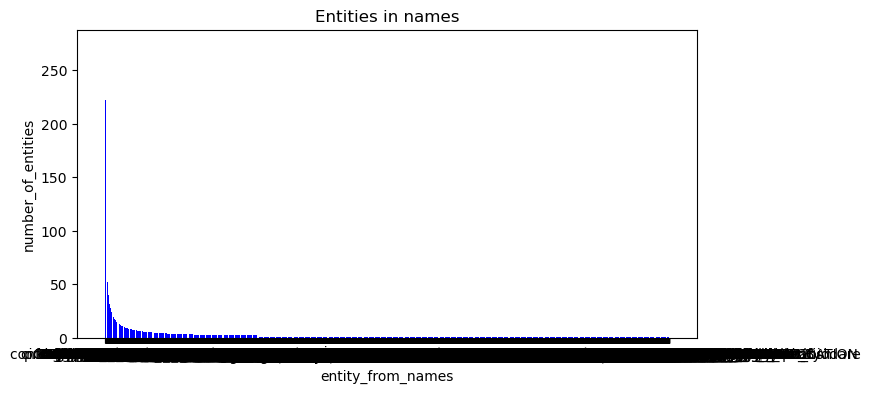

In [395]:
plt.figure(figsize=(8,4))
plt.bar(df_count_name_entities_sorted['entity_from_names'], df_count_name_entities_sorted['number_of_entities'],
      color = 'blue')
plt.xlabel('entity_from_names')
plt.ylabel('number_of_entities')
plt.title('Entities in names')
warnings.filterwarnings("ignore", category=UserWarning)
plt.show()

In [396]:
max_row = df_count_name_entities_sorted.loc[df_count_name_entities_sorted['number_of_entities'].idxmax()]

In [397]:
max_row

entity_from_names      LD
number_of_entities    274
Name: 25855, dtype: object

In [404]:
threshold = 100
df_count_name_entities_filtered = df_count_name_entities_sorted[df_count_name_entities_sorted['number_of_entities'] > threshold]

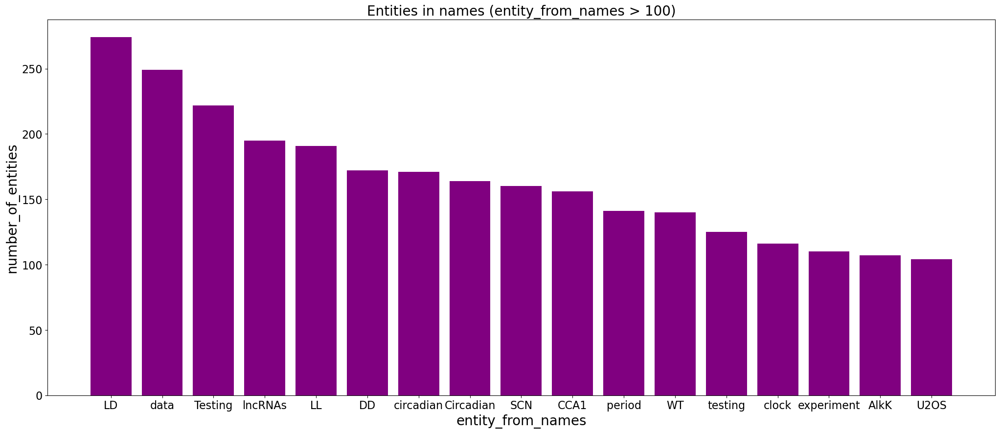

In [413]:
plt.figure(figsize=(25,10))
plt.bar(df_count_name_entities_filtered['entity_from_names'], df_count_name_entities_filtered['number_of_entities'],
      color = 'purple')
plt.xlabel('entity_from_names', fontsize = 20)
plt.ylabel('number_of_entities', fontsize = 20)
plt.yticks(fontsize = 16)
plt.xticks(fontsize = 16)
plt.title(f'Entities in names (entity_from_names > {threshold})', fontsize = 20)
warnings.filterwarnings("ignore", category=UserWarning)
plt.show()